# Toulouse (FR) Street names - Gender analysis

In [1]:
import numpy as np
import pandas as pd

In [ ]:
pip install plotly.express

Note: you may need to restart the kernel to use updated packages.


In [2]:
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
%matplotlib inline

# Domain knowledge

In [3]:
# Domain specific stopwords (not relevant for prediction)
stopwords = set(["aux", "de", "des", "del", "dit", "du", "en", "et", "la", "las", "le", # mots de liaison
                 "allée", "avenue", "boulevard", "carrefour", "cité", "chemin", "impasse", "cour", "clos", # type voie
                 "enclos", "place", "passage", "pont", "quai", "rond-point", "rue", "square", "tunnel", "voie", # type voie
                 "faubourg", "route", "via", "puits", "jeu",
                 "bassin", "bois", "colline", "croix", "fontaine", "esplanade", "jardin", # environement
                 "château", "ecole", "ecoles", "espace", "loge", "moulin", "mas", "palais", "parvis", "passerelle", # environement
                 "jardins", "parc", "parking", "petit", "petite", "plan",  "tour", # environement
                 "blanc", "rouge", "roses", "vieille", "bon",
                 "deux", "quatre", # chiffres
                 "toulouse", "balma", # villes
                 "cheval", "merle", # animaux
                 "belle", "val", "mai" # prenoms from data.gouv.fr (ambigu)
                ])

In [4]:
# Prenom & genre de data.gouv.fr
url0 = "https://static.data.gouv.fr/resources/liste-de-prenoms/20141127-154433/Prenoms.csv"
names = pd.read_csv(url0, encoding = "latin", sep=";", usecols=["01_prenom", "02_genre"], index_col="01_prenom")
names = names.to_dict()['02_genre'] # mapping from name to gender, ex: Anne -> 'f' (or 'm', 'm,f')

In [5]:
# Extra women names/patterns (not in data.gouv.fr list)
for w in ["sainte", "simone"]:
    names[w] = "f"

In [6]:
# Extra men names/patterns (not in data.gouv.fr list)
for w in ["alexis", "antonin", "claude", "edouard", "emile", "etienne", "fabre", "francis",
          "hippolyte", "guilhem", "jean", "jules", "georges",  # <!> exceptions, georges sand
          "abbé", "père", "pasteur", # professions religieuse au masculin
          "colonel", "général", "maréchal", # professions militaire au masculin
          "professeur", "docteur", # autres professions au masculin
          "comte", "frères", "roi", # autres, statut social au masculin
          "saint"]:
    names[w] = "m"

# 1. Prepare dataset

In [8]:
def load_dataset(url: str):
    """
    Args:
        url: str, a link pointing a csv file, e.g., at data.montpellier3m.fr or opendata.paris.fr
    Returns:
        df: pd.DataFrame, a table containing street names as rows (along with lat, long)
    """

    # read dataset
    df = pd.read_csv(url, sep=";")

    # keep relevant columns
    df = df[['code_insee', 'commune', 'libelle', 'long', 'lat']]

    # drop duplicate rows (group addresses --> average latitudes and longitudes to get coordinates of center)
    df = df.groupby(by=['code_insee', 'commune', 'libelle']).mean()

    # reset index
    df = df.reset_index()
    return df

# 2. Label street names

In [9]:
def label_street(name: str):
    """
    Args:
        name: str, street name
    Returns:
        label: int, 0 (no gender), 1 (M), 2 (F), 1.5 (uncertain or mixed H/F)
    """

    # preprocess string (lower case, remove digits and punctuation)
    name = name.lower()
    for d in "0123456789-'":
        name = name.replace(d, ' ')

    # iterate over each street words and return 1 (resp 2) if M (resp F) pattern for first name (prenom A)
    for w in name.split():
        w = w.strip() # remove extra white spaces
        if w not in stopwords and w in names:
            gender = names[w]
            if gender == 'f':
                return 2
            elif gender == 'm':
                return 1
    return 0 # no label

In [40]:
### CODE POUR TOULOUSE

# L'URL du fichier CSV
url = "https://data.toulouse-metropole.fr/explore/dataset/numero-de-rue/download/?format=csv&timezone=Europe/Berlin&lang=fr&use_labels_for_header=true"

# Charger les données dans un DataFrame pandas
df = pd.read_csv(url, sep=';')

# Afficher les premières lignes du DataFrame
df.head()


,Geo Point,Geo Shape,numero,repetition,num_long,libelle,sti,rivoli,code_postal,commune,code_insee
0,"43.55280402402323,1.3760411088690365","{""coordinates"": [[1.376041108869037, 43.552804...",157,NaN,0157,CHEMIN DE TUCAUT,315556995248,3105558624K,31100,TOULOUSE,31555
1,"43.60685272819678,1.3994932399247562","{""coordinates"": [[1.399493239924756, 43.606852...",277,NaN,0277,AVENUE DE GRANDE BRETAGNE,315553289623,3105553984S,31300,TOULOUSE,31555
2,"43.668961492681866,1.4343251796311667","{""coordinates"": [[1.434325179631167, 43.668961...",8,NaN,0008,PLACE DU CHANT DU MERLE,310220000104,3100220097J,31140,AUCAMVILLE,31022
3,"43.55635001518338,1.5216748473031643","{""coordinates"": [[1.521674847303164, 43.556350...",34,NaN,0034,RUE DES SEYCHELLES,315060000184,3105061185M,31650,SAINT ORENS DE GAMEVILLE,31506
4,"43.58956832692713,1.4110575291507172","{""coordinates"": [[1.411057529150717, 43.589568...",19,NaN,0019,RUE DE BAGNOLET,315550483215,3105550781K,31100,TOULOUSE,31555


In [42]:
df["long"] = df['Geo Point'].str.split(",", expand = True)[1].astype(float)
df["lat"] = df['Geo Point'].str.split(",", expand = True)[0].astype(float)

In [12]:
df.head()

,Geo Point,Geo Shape,numero,repetition,num_long,libelle,sti,rivoli,code_postal,commune,code_insee,long,lat
0,"43.55280402402323,1.3760411088690365","{""coordinates"": [[1.376041108869037, 43.552804...",157,NaN,0157,CHEMIN DE TUCAUT,315556995248,3105558624K,31100,TOULOUSE,31555,1.3760411088690365,43.55280402402323
1,"43.60685272819678,1.3994932399247562","{""coordinates"": [[1.399493239924756, 43.606852...",277,NaN,0277,AVENUE DE GRANDE BRETAGNE,315553289623,3105553984S,31300,TOULOUSE,31555,1.3994932399247562,43.60685272819678
2,"43.668961492681866,1.4343251796311667","{""coordinates"": [[1.434325179631167, 43.668961...",8,NaN,0008,PLACE DU CHANT DU MERLE,310220000104,3100220097J,31140,AUCAMVILLE,31022,1.4343251796311667,43.668961492681866
3,"43.55635001518338,1.5216748473031643","{""coordinates"": [[1.521674847303164, 43.556350...",34,NaN,0034,RUE DES SEYCHELLES,315060000184,3105061185M,31650,SAINT ORENS DE GAMEVILLE,31506,1.5216748473031643,43.55635001518338
4,"43.58956832692713,1.4110575291507172","{""coordinates"": [[1.411057529150717, 43.589568...",19,NaN,0019,RUE DE BAGNOLET,315550483215,3105550781K,31100,TOULOUSE,31555,1.4110575291507172,43.58956832692713


In [43]:
df.dtypes

Geo Point       object
Geo Shape       object
numero           int64
repetition      object
num_long        object
libelle         object
sti              int64
rivoli          object
code_postal      int64
commune         object
code_insee       int64
long           float64
lat            float64
dtype: object

In [44]:
# Test on Toulouse (FR) street names
df["label"] = df['libelle'].apply(label_street)
df.head()

,Geo Point,Geo Shape,numero,repetition,num_long,libelle,sti,rivoli,code_postal,commune,code_insee,long,lat,label
0,"43.55280402402323,1.3760411088690365","{""coordinates"": [[1.376041108869037, 43.552804...",157,NaN,0157,CHEMIN DE TUCAUT,315556995248,3105558624K,31100,TOULOUSE,31555,1.376041,43.552804,0
1,"43.60685272819678,1.3994932399247562","{""coordinates"": [[1.399493239924756, 43.606852...",277,NaN,0277,AVENUE DE GRANDE BRETAGNE,315553289623,3105553984S,31300,TOULOUSE,31555,1.399493,43.606853,0
2,"43.668961492681866,1.4343251796311667","{""coordinates"": [[1.434325179631167, 43.668961...",8,NaN,0008,PLACE DU CHANT DU MERLE,310220000104,3100220097J,31140,AUCAMVILLE,31022,1.434325,43.668961,0
3,"43.55635001518338,1.5216748473031643","{""coordinates"": [[1.521674847303164, 43.556350...",34,NaN,0034,RUE DES SEYCHELLES,315060000184,3105061185M,31650,SAINT ORENS DE GAMEVILLE,31506,1.521675,43.556350,0
4,"43.58956832692713,1.4110575291507172","{""coordinates"": [[1.411057529150717, 43.589568...",19,NaN,0019,RUE DE BAGNOLET,315550483215,3105550781K,31100,TOULOUSE,31555,1.411058,43.589568,0


# 3. Analysis

## 3.1 Names distribution / language model

In [45]:
def get_sorted_vocab(corpus):
    """
    Args:
        corpus: list of str
    Returns:
        vocab: list of str, words in corpus
        counts: list of int, word counts
    """

    # save word counts as a dictionnary
    counts_dict = {}
    for name in corpus:
        for w in name.split():
            w = w.lower().strip()
            if w not in stopwords and len(w)>0:
                if w in counts_dict:
                    counts_dict[w] +=1
                else:
                    counts_dict[w] =1

    # sort vocabulary by counts
    names = np.array(list(counts_dict.keys()))
    counts = np.array(list(counts_dict.values()))
    sorted_idx = np.argsort(counts)[::-1]
    return names[sorted_idx], counts[sorted_idx], counts_dict

In [46]:
# get vocabulary and word counts
corpus = df['libelle'].values
vocab, counts, counts_dict = get_sorted_vocab(corpus)
print('{} words found'.format(len(counts)))
print(' {} words occur 2+ times (total counts {})'.format(len([c for c in counts if c>1]), sum([c for c in counts if c>1])))
print(" Louis in vocab:", "louis" in vocab) # test if name in vocab

5207 words found
 5074 words occur 2+ times (total counts 241982)
 Louis in vocab: True


In [ ]:
# inspect data (2+ occurence and not labeled as masculin or feminin)
#for i in range(len(vocab)):
#    if counts[i]>1 and label_street(vocab[i]) == 0:
#        print(vocab[i], counts[i])

### 3.1.1 Femmes vs Homme names dans le top 50 et top 100

In [47]:
def print_stats_topk(k: int = 100):
    sorted_labels = [label_street(w) for w in vocab if label_street(w) in [1.0, 2.0]]
    topk_m = len([l for l in sorted_labels[:k] if l == 1.0])
    topk_f = len([l for l in sorted_labels[:k] if l == 2.0])
    ratio_topk = 100*topk_f/(topk_m+topk_f)
    print("Top{} names 'F' = {} vs. 'M' = {} ({:.1f}% representativité)".format(k, topk_f, topk_m, ratio_topk))

In [48]:
print_stats_topk(k=50)
print_stats_topk(k=100)

Top50 names 'F' = 3 vs. 'M' = 47 (6.0% representativité)
Top100 names 'F' = 17 vs. 'M' = 83 (17.0% representativité)


### 3.1.2 Word distribution and gender bias

In [49]:
# plot power law, long tail distribution and bias (color blue M, red W, gray No Label)
def plot_word_distr(offset: int = 0, limit: int = 50):
    plt.figure(1, figsize=(15,5))
    color = {0: "gray", 1: "blue", 2: "red"}
    colors = [color[label_street(w)] for w in vocab[offset:offset+limit]]
    plt.scatter(np.arange(limit), counts[offset:offset+limit], c=colors)
    plt.plot(counts[offset:offset+limit], color="gray", linestyle='dashed')
    plt.xticks(np.arange(limit), vocab[offset:offset+limit], rotation=45)
    for ticklabel, tickcolor in zip(plt.gca().get_xticklabels(), colors):
        ticklabel.set_color(tickcolor)
    plt.ylabel("counts")
    plt.title("Toulouse (FR) - Common street names sorted by counts ({}-{})".format(offset,offset+limit))
    plt.show()

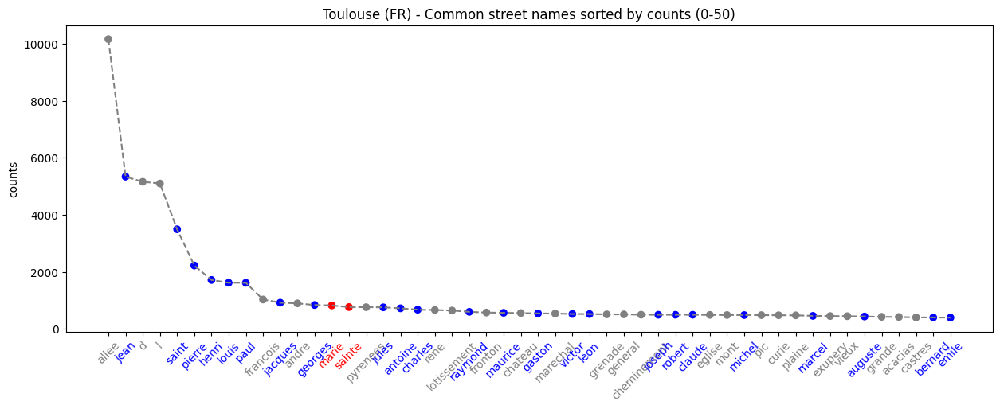

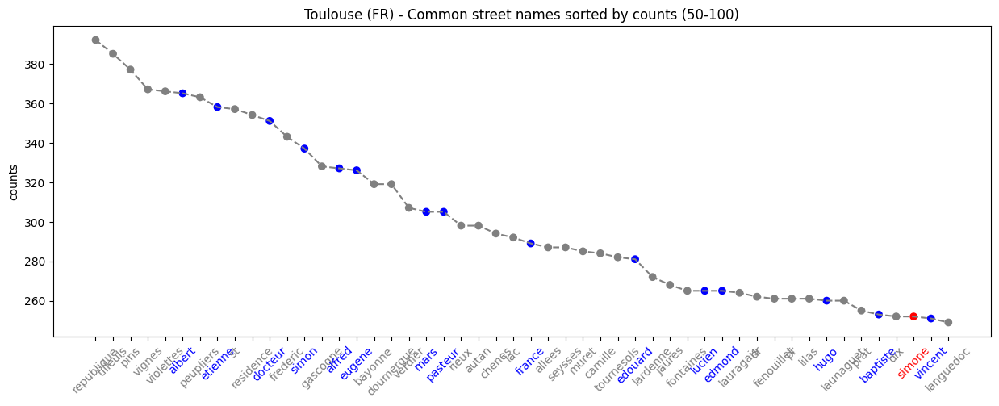

In [50]:
plot_word_distr(offset=0, limit=50)
plot_word_distr(offset=50, limit=50)

## 3.2 Gender bias - Street statistics

In [51]:
print(len(df), 'streets in Toulouse')

159692 streets in Toulouse


In [ ]:
# plot distribution (street names gender distribution)
#df["label"].hist()
#plt.title("Montpellier (FR) - Street names gender distribution")
#plt.xticks([0,1,1.5,2], ["No label", "M", "M/F", "F"])
#plt.show()

### 3.2.1 Rues portant des noms de Femme vs Homme

Note: Statistique sensible à l'algorithme de classification

In [52]:
n_street_f = len(df[df["label"]==2]) # ex: Square Edith Piaf
n_street_m = len(df[df["label"]==1]) # ex: Boulevard Paul Valéry
ratio_f = 100*n_street_f/(n_street_m + n_street_f)

In [53]:
print("Street 'F' = {} vs. 'M' = {} ({:.1f}% representativité)".format(n_street_f, n_street_m, ratio_f))

Street 'F' = 5576 vs. 'M' = 39018 (12.5% representativité)


### 3.2.2 Rues nommées Sainte vs. Saint ...

Solution la plus simple pour calculer le biais dans une commune / métropole. Limite: High variance estimator (low n sample)

In [54]:
n_occurence_ste = counts_dict["sainte"] # ex: 'Sainte Genevieve'
n_occurence_st = counts_dict["saint"] # ex: 'Saint Pierre'
ratio_ste = 100*n_occurence_ste/(n_occurence_st+n_occurence_ste)

In [55]:
print("Occurence 'Ste' = {} vs. 'St' = {} ({:.1f}% representativité)".format(n_occurence_ste, n_occurence_st, ratio_ste))

Occurence 'Ste' = 766 vs. 'St' = 3493 (18.0% representativité)


## 3.3 Analyse par type de voie

In [56]:
# distribution par type de voie (square, avenue, boulevard...)
types_de_voie = ["allée", "avenue", "boulevard", "carrefour", "cité", "chemin", "impasse", # type voie
                 "place", "passage", "pont", "quai", "rond-point", "rue", "square", # type voie
                 "fontaine", "esplanade", "espace", "loge", # environement
                 "parvis", "passerelle", "jardins", "parc",
                ]

df["voie_type"] = "autre"
for v in types_de_voie:
    df.loc[df["libelle"].str.lower().str.contains(v+" "), "voie_type"] = v

In [57]:
df["F"] = 0
df["M"] = 0
df.loc[df["label"].astype(int)==2, "F"] = 1
df.loc[df["label"].astype(int)==1, "M"] = 1

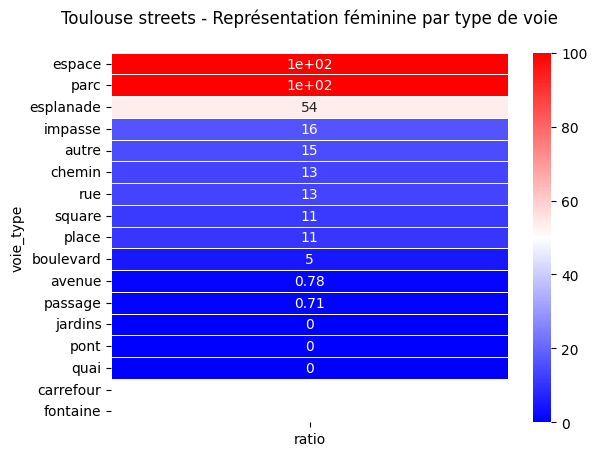

In [58]:
df_by_type = df[["voie_type", "F", "M"]].groupby(["voie_type"]).sum()
df_by_type["ratio"] = 100*df_by_type["F"]/(df_by_type["F"]+df_by_type["M"])
df_by_type = df_by_type.sort_values(["ratio"], ascending=False)

# plot representation by type of voie
sns.heatmap(df_by_type[["ratio"]], cmap='bwr', linewidths=0.5, annot=True)
plt.title("Toulouse streets - Représentation féminine par type de voie\n")
plt.show()

## 3.4 Geospatial analysis

### 3.4.1 [Toulouse](https://data.toulouse-metropole.fr/explore/dataset/numero-de-rue/download/?format=csv&timezone=Europe/Berlin&lang=fr&use_labels_for_header=true), Occitanie

In [59]:
# rename label 0, 1, 2... for visualization
df["label"] = df["label"].astype(int)
df.loc[df["label"]==0, "label"] = "None"
df.loc[df["label"]==1, "label"] = "M"
df.loc[df["label"]==2, "label"] = "F"
#df.loc[df["label"]==1.5, "label"] = "M/F"

In [60]:
fig = px.scatter_mapbox(df, lat="lat", lon="long", zoom=12,
                        color="label",
                        color_discrete_map={
                            "None":"#000000", # black
                            "M":"#0000FF", # blue
                            "F":"#FF0000", # red
                            "M/F":"#A020F0", # violet
                        },
                        #size="type_de_voie",
                        size_max=10,
                        opacity=0.5,
                        hover_name="libelle",
                        hover_data={
                            "lat":":.3f",
                            "long":":.3f",
                            "label": True,
                            "libelle": True
                        },
                        mapbox_style = "stamen-toner", # no token required for 'open-street-map', 'carto-positron', 'stamen-toner'
                        title="{} streets - Gender analysis".format(df["commune"][0]),
                        height=750, # figure height in pixel
                       )
fig.show()